# **Problem Statement**

- Ninjacart is India's largest fresh produce supply chain company. They are pioneers in solving one of the toughest supply chain problems of the world by leveraging innovative technology. 
- They source fresh produce from farmers and deliver them to businesses within 12 hours. 
- An integral component of their automation process is the `development of robust classifiers which can distinguish between images of different types of vegetables`, while also `correctly labeling images that do not contain any one type of vegetable as noise.`



- As a starting point, ninjacart has provided us with a dataset scraped from the web which contains train and test folders, each having 4 sub-folders with images of onions, potatoes, tomatoes and some market scenes. 
- We have been tasked with preparing a multiclass classifier for identifying these vegetables. The dataset provided has all the required images to achieve the task.



## Context

- This dataset contains images of the following food items: noise-Indian market and images of vegetables- onion, potato and tomato.

## Data Collection

- The images in this dataset were scraped from Google.

## Content

- This dataset contains a folder train, which has a total of 3135 images, split into four folders as follows:

  - Tomato : 789

  - Potato : 898

  - Onion : 849

  - Indian market : 599

- This dataset contains another folder test which has a total of 351 images, split into four folders

  - Tomato : 106

  - potato : 83

  - onion : 81

  - Indian market : 81

## **Objective :** 

- The objective is to develop a program that can recognize the vegetable item(s) in a photo and identify them for the user.

### **Concepts Tested**:

- Dataset Preparation & Visualization

- CNN models

- Implementing Callbacks

- Deal with Overfitting

- Transfer Learning

# Downloading Data

In [1]:
!gdown 1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT

Downloading...
From: https://drive.google.com/uc?id=1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT
To: /content/ninjacart_data.zip
100% 275M/275M [00:03<00:00, 80.2MB/s]


# unzip

In [2]:
%%time 

!unzip -q /content/ninjacart_data.zip

CPU times: user 16.4 ms, sys: 7.5 ms, total: 23.9 ms
Wall time: 2.22 s


 # Importing common libraries

In [3]:

%%time

import os
import glob
import random
import numpy as np
import pandas as pd
import sklearn.metrics as metrics
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# Import tensorflow and its modules
import tensorflow as tf
from tensorflow import keras # this allows <keras.> instead of <tf.keras.>
from tensorflow.keras import layers # this allows <layers.> instead of <tf.keras.layers.>
tf.keras.utils.set_random_seed(111) # set random seed

# To supress any warnings during the flow
import warnings
warnings.filterwarnings('ignore')

CPU times: user 2.8 s, sys: 419 ms, total: 3.22 s
Wall time: 3.81 s


# train data distribution

In [ ]:
# train data distribution

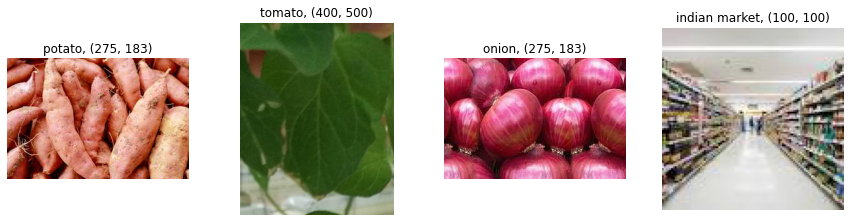

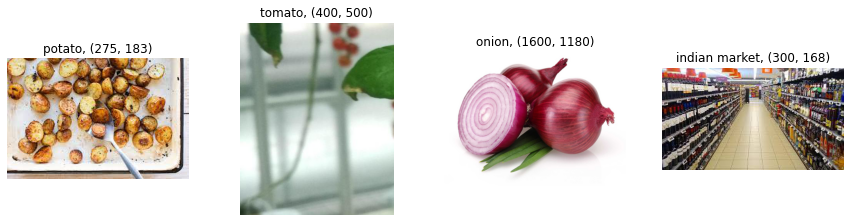

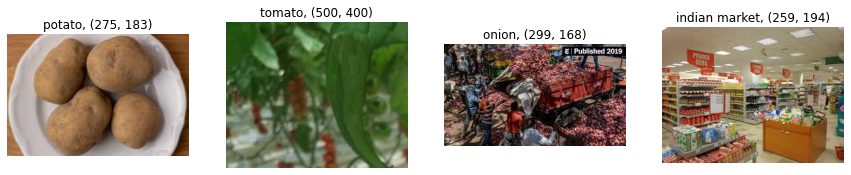

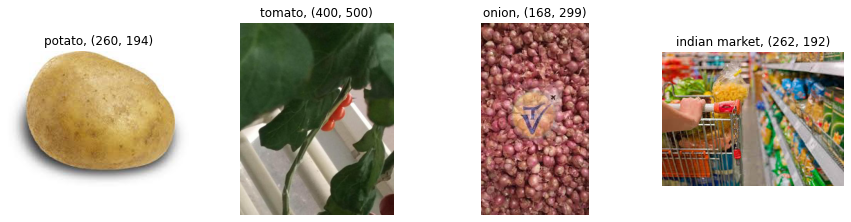

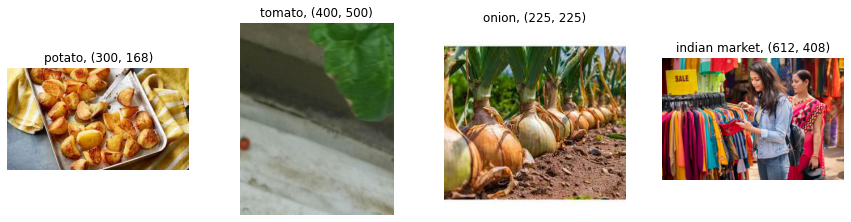




Count of training samples per class:
            class  count
0         potato    898
1         tomato    789
2          onion    849
3  indian market    599



CPU times: user 2.95 s, sys: 392 ms, total: 3.34 s
Wall time: 3.49 s


<Axes: title={'center': 'Training Data Count per class'}, xlabel='class'>

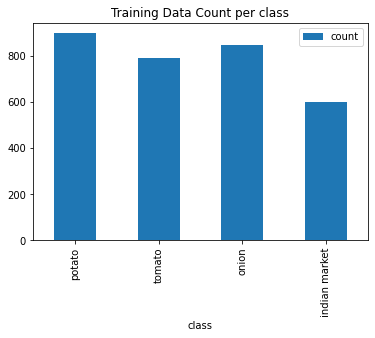

In [ ]:
%%time 

class_dirs_train = os.listdir("ninjacart_data/train") # list all directories inside "train" folder
image_dict_train = {} # dict to store image array(key) for every class(value)
count_dict_train = {} # dict to store count of files(key) for every class(value)

for _ in range(5):
  # iterate over all class_dirs
  for cls in class_dirs_train:
      # get list of all paths inside the subdirectory
      file_paths = glob.glob(f'ninjacart_data/train/{cls}/*')
      # count number of files in each class and add it to count_dict_train
      count_dict_train[cls] = len(file_paths)
      # select random item from list of image paths
      image_path = random.choice(file_paths)
      # load image using keras utility function and save it in image_dict_train
      image_dict_train[cls] = tf.keras.utils.load_img(image_path)
    
  ## Viz Random Sample from each class

  plt.figure(figsize=(15, 12))
  # iterate over dictionary items (class label, image array)
  for i, (cls,img) in enumerate(image_dict_train.items()):    
      # create a subplot axis
      ax = plt.subplot(3, 4, i + 1)
      # plot each image
      plt.imshow(img)
      # set "class name" along with "image size" as title 
      plt.title(f'{cls}, {img.size}')
      plt.axis("off")

  plt.show()

  ## Let's now Plot the Data Distribution of Training Data across Classes
df_count_train = pd.DataFrame({
    "class": count_dict_train.keys(),     # keys of count_dict are class labels
    "count": count_dict_train.values(),   # value of count_dict contain counts of each class
})

print()
print()
print()

print("Count of training samples per class:\n", df_count_train)

print()
print()
print()

# draw a bar plot using pandas in-built plotting function
df_count_train.plot.bar(x='class', y='count', title="Training Data Count per class") 

In [ ]:
# test data distribution

# test data distribution

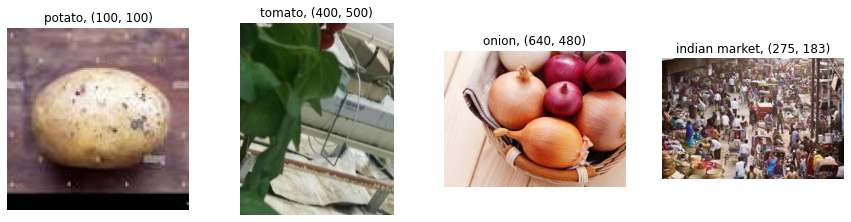

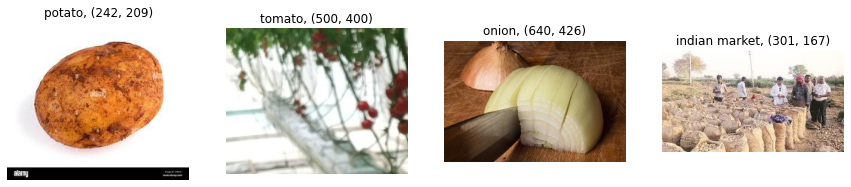

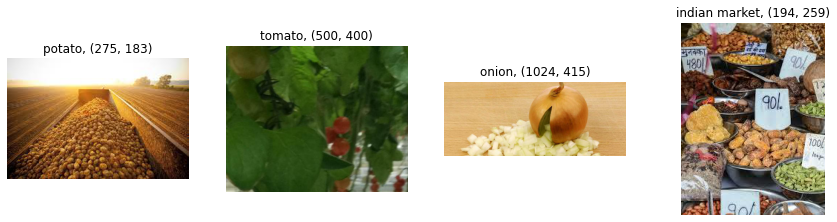

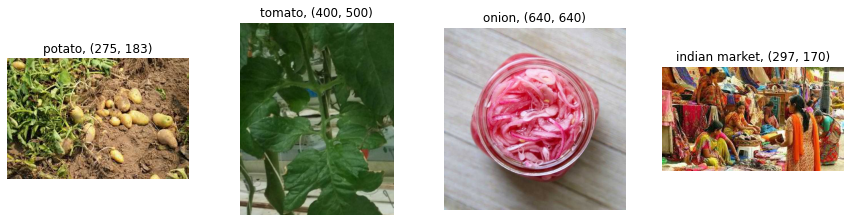

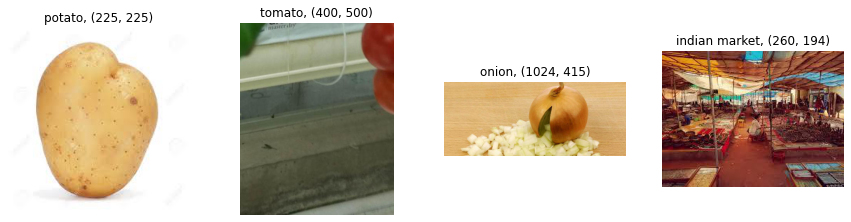




Count of test samples per class:
            class  count
0         potato     81
1         tomato    106
2          onion     83
3  indian market     81



CPU times: user 2.66 s, sys: 272 ms, total: 2.93 s
Wall time: 4.27 s


<Axes: title={'center': 'test Data Count per class'}, xlabel='class'>

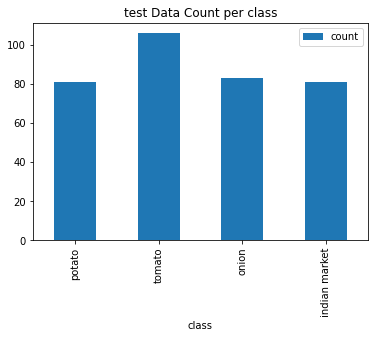

In [ ]:

%%time


class_dirs_test = os.listdir("ninjacart_data/test") # list all directories inside "train" folder
image_dict_test = {} # dict to store image array(key) for every class(value)
count_dict_test = {} # dict to store count of files(key) for every class(value)

for _ in range(5):
  # iterate over all class_dirs_test
  for cls in class_dirs_test:
      # get list of all paths inside the subdirectory
      file_paths = glob.glob(f'ninjacart_data/test/{cls}/*')
      # count number of files in each class and add it to count_dict_test
      count_dict_test[cls] = len(file_paths)
      # select random item from list of image paths
      image_path = random.choice(file_paths)
      # load image using keras utility function and save it in image_dict
      image_dict_test[cls] = tf.keras.utils.load_img(image_path)
    
  ## Viz Random Sample from each class

  plt.figure(figsize=(15, 12))
  # iterate over dictionary items (class label, image array)
  for i, (cls,img) in enumerate(image_dict_test.items()):    
      # create a subplot axis
      ax = plt.subplot(3, 4, i + 1)
      # plot each image
      plt.imshow(img)
      # set "class name" along with "image size" as title 
      plt.title(f'{cls}, {img.size}')
      plt.axis("off")

  plt.show()

## Let's now Plot the Data Distribution of testing Data across Classes
df_count_test = pd.DataFrame({
    "class": count_dict_test.keys(),     # keys of count_dict are class labels
    "count": count_dict_test.values(),   # value of count_dict contain counts of each class
})

print()
print()
print()
print("Count of test samples per class:\n", df_count_test)

print()
print()
print()

# draw a bar plot using pandas in-built plotting function
df_count_test.plot.bar(x='class', y='count', title="test Data Count per class") 

# **Loading, Resizing the data into TensorFlow** 

In [ ]:
import tensorflow as tf
import os
from sklearn.model_selection import train_test_split


In [ ]:
train_dir = '/content/ninjacart_data/train'
test_dir = '/content/ninjacart_data/test'

train_filenames = tf.io.gfile.glob(train_dir + '/*/*')
test_filenames = tf.io.gfile.glob(test_dir + '/*/*')

train_labels = [os.path.basename(os.path.dirname(filename)) for filename in train_filenames]
test_labels = [os.path.basename(os.path.dirname(filename)) for filename in test_filenames]


In [ ]:
np.unique(np.array(test_labels))

array(['indian market', 'onion', 'potato', 'tomato'], dtype='<U13')

In [ ]:
train_filenames, val_filenames, train_labels, val_labels = train_test_split(train_filenames, train_labels, test_size=0.2)


In [ ]:
data_dir = '/content/ninjacart_data/train'
img_size = (128, 128) # set the desired image size for your model


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_data_gen = ImageDataGenerator(
    rescale=1./255, # normalize pixel values
    validation_split=0.2 # set the validation split to 20%
)

train_data = train_data_gen.flow_from_directory(
    data_dir,
    target_size=img_size,
    batch_size=32, # set the batch size for training data
    class_mode='categorical',
    subset='training'
)

val_data = train_data_gen.flow_from_directory(
    data_dir,
    target_size=img_size,
    batch_size=32, # set the batch size for validation data
    class_mode='categorical',
    subset='validation'
)


Found 2511 images belonging to 4 classes.
Found 624 images belonging to 4 classes.


In [ ]:
data_gen = ImageDataGenerator(
    rescale=1./255, # normalize pixel values

)



test_data = data_gen.flow_from_directory(
    test_dir,
    target_size=img_size,
    class_mode='categorical',
    shuffle=False  # don't shuffle the data
)

Found 351 images belonging to 4 classes.


In [ ]:
height, width = img_size
height, width

(128, 128)

In [ ]:
# Creating base ANN model : 

# **ANN model** : 

In [ ]:
num_classes = 4
hidden_size_1 = 256
hidden_size_2 = 256


model = keras.Sequential(
    name="model_ANN",
    layers=[
        
        

        layers.Flatten(input_shape=(height, width, 3)),
        
        layers.Dense(units=hidden_size_1, activation='relu'), # hidden layer 1
        layers.Dense(units=hidden_size_2, activation='relu'), # hidden layer 2
        

        layers.Dense(units=num_classes, activation='softmax'), # output layer
    ]
)

model.summary()



Model: "model_ANN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 256)               12583168  
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dense_2 (Dense)             (None, 4)                 1028      
                                                                 
Total params: 12,649,988
Trainable params: 12,649,988
Non-trainable params: 0
_________________________________________________________________


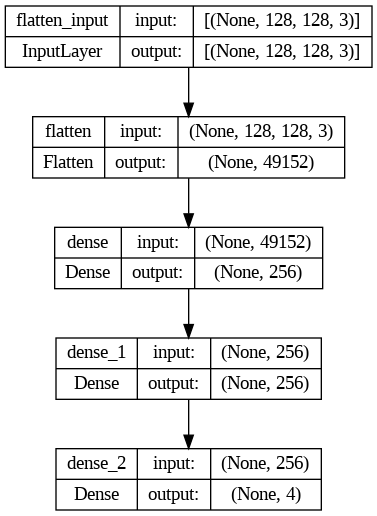

In [ ]:

tf.keras.utils.plot_model(model, to_file="model_ANN.png", show_shapes=True)



In [ ]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:

epochs = 15
model_fit = model.fit(train_data,
                      steps_per_epoch=train_data.samples//train_data.batch_size, # set the steps per epoch
                      validation_data=val_data,
                      validation_steps=val_data.samples//val_data.batch_size, # set the validation steps
                      epochs=epochs)



Epoch 1/15
78/78 [==============================] - 19s 222ms/step - loss: 7.4552 - accuracy: 0.3897 - val_loss: 1.2296 - val_accuracy: 0.5329
Epoch 2/15
78/78 [==============================] - 18s 229ms/step - loss: 1.0211 - accuracy: 0.6370 - val_loss: 1.0521 - val_accuracy: 0.5789
Epoch 3/15
78/78 [==============================] - 22s 284ms/step - loss: 0.9280 - accuracy: 0.6478 - val_loss: 1.1942 - val_accuracy: 0.6036
Epoch 4/15
78/78 [==============================] - 25s 322ms/step - loss: 0.8190 - accuracy: 0.6914 - val_loss: 0.8565 - val_accuracy: 0.6875
Epoch 5/15
78/78 [==============================] - 20s 253ms/step - loss: 0.7475 - accuracy: 0.7168 - val_loss: 0.9300 - val_accuracy: 0.6250
Epoch 6/15
78/78 [==============================] - 25s 316ms/step - loss: 0.7467 - accuracy: 0.7039 - val_loss: 1.0266 - val_accuracy: 0.6086
Epoch 7/15
78/78 [==============================] - 17s 217ms/step - loss: 0.7729 - accuracy: 0.6846 - val_loss: 1.1354 - val_accuracy: 0.5740

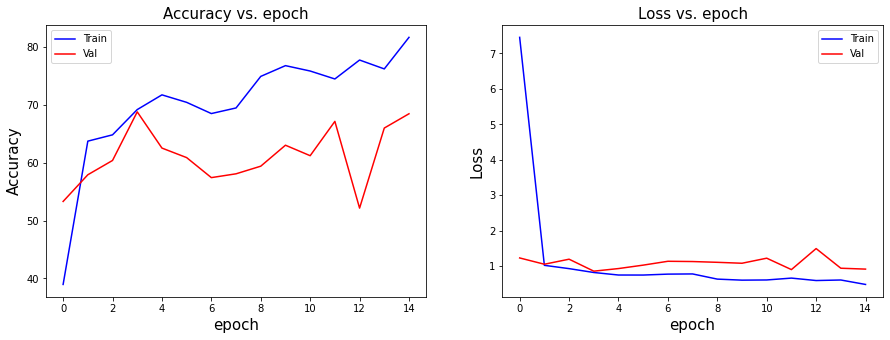

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
ax = axes.ravel()

#accuracy graph
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['accuracy']], label='Train', color='b')
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['val_accuracy']], label='Val', color='r')
ax[0].set_title('Accuracy vs. epoch', fontsize=15)
ax[0].set_ylabel('Accuracy', fontsize=15)
ax[0].set_xlabel('epoch', fontsize=15)
ax[0].legend()

#loss graph
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['loss'], label='Train', color='b')
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['val_loss'], label='Val', color='r')
ax[1].set_title('Loss vs. epoch', fontsize=15)
ax[1].set_ylabel('Loss', fontsize=15)
ax[1].set_xlabel('epoch', fontsize=15)
ax[1].legend()

#display the graph
plt.show()

11/11 [==============================] - 2s 153ms/step - loss: 1.0572 - accuracy: 0.6154
Test accuracy: 0.6153846383094788


11/11 [==============================] - 2s 151ms/step
Confusion matrix:
[[27 19 29  6]
 [ 6 36 36  5]
 [10 13 57  1]
 [ 6  2  2 96]]
Classification report:
               precision    recall  f1-score   support

indian market       0.55      0.33      0.42        81
        onion       0.51      0.43      0.47        83
       potato       0.46      0.70      0.56        81
       tomato       0.89      0.91      0.90       106

     accuracy                           0.62       351
    macro avg       0.60      0.59      0.58       351
 weighted avg       0.62      0.62      0.61       351







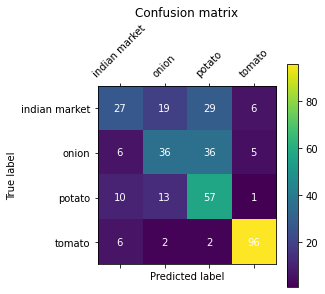

In [ ]:
test_loss, test_acc = model.evaluate(test_data)


print('Test accuracy:', test_acc)

print()
print()


y_true = test_data.labels
y_pred = np.argmax(model.predict(test_data), axis=-1)

from sklearn.metrics import classification_report, confusion_matrix

cm = confusion_matrix(y_true, y_pred)



print('Confusion matrix:')
print(cm)

# Print the classification report
class_names = list(train_data.class_indices.keys())
report = classification_report(y_true, y_pred, target_names=class_names)
print('Classification report:')
print(report)

print()
print()
print()
print()


# Plot confusion matrix
plt.matshow(cm)
plt.title('Confusion matrix')
plt.colorbar()
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.xticks(np.arange(len(class_names)), class_names, rotation=45)
plt.yticks(np.arange(len(class_names)), class_names)


# Add text annotations to confusion matrix
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, cm[i, j], ha='center', va='center', color='white')

plt.show()

# **CNN** 


## **CNN Architecture 1:**

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

model = Sequential(
    
    name="model_CNN",
    layers = [
    

    Conv2D(filters = 32,
           kernel_size = (3, 3),
           activation='relu',
           padding="same" ,
           input_shape=(128, 128, 3)),
    MaxPooling2D((2, 2)),


    Conv2D(64,
           (3, 3),
           padding="same" ,
           activation='relu'),
    MaxPooling2D((2, 2)),


    Conv2D(128, 
           (3, 3),
           padding="same",
           activation='relu'),
    MaxPooling2D((2, 2)),

    
    Flatten(),


    Dense(128, activation='relu'),
    Dense(4, activation='softmax')
])




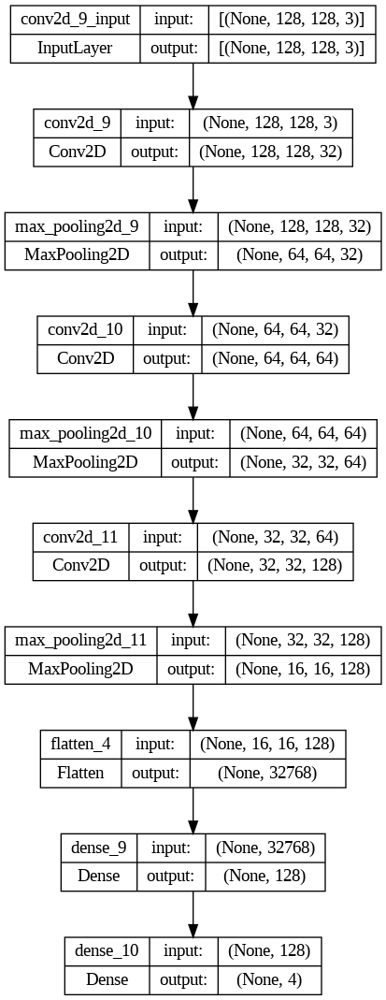

In [ ]:
tf.keras.utils.plot_model(model, to_file="model_CNN.png", show_shapes=True)

In [ ]:
model.summary()

Model: "model_CNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 128, 128, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 32, 32, 64)       0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 32, 32, 128)       73856     
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 16, 16, 128)      0 

In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
model_fit = model.fit(
    train_data,
    steps_per_epoch=train_data.samples//train_data.batch_size, # set the steps per epoch
    validation_data=val_data,
    validation_steps=val_data.samples//val_data.batch_size, # set the validation steps
    epochs=10 # set the number of epochs
)


Epoch 1/10
78/78 [==============================] - 19s 220ms/step - loss: 0.9302 - accuracy: 0.6168 - val_loss: 0.6767 - val_accuracy: 0.7385
Epoch 2/10
78/78 [==============================] - 15s 189ms/step - loss: 0.4770 - accuracy: 0.8161 - val_loss: 0.6175 - val_accuracy: 0.7632
Epoch 3/10
78/78 [==============================] - 16s 209ms/step - loss: 0.3917 - accuracy: 0.8528 - val_loss: 0.5281 - val_accuracy: 0.7862
Epoch 4/10
78/78 [==============================] - 17s 213ms/step - loss: 0.3382 - accuracy: 0.8697 - val_loss: 0.5281 - val_accuracy: 0.8109
Epoch 5/10
78/78 [==============================] - 16s 209ms/step - loss: 0.3170 - accuracy: 0.8745 - val_loss: 0.4418 - val_accuracy: 0.8240
Epoch 6/10
78/78 [==============================] - 16s 205ms/step - loss: 0.2280 - accuracy: 0.9117 - val_loss: 0.4180 - val_accuracy: 0.8503
Epoch 7/10
78/78 [==============================] - 15s 190ms/step - loss: 0.1912 - accuracy: 0.9266 - val_loss: 0.4427 - val_accuracy: 0.8355

In [ ]:
test_loss, test_acc = model.evaluate(test_data)


print('Test accuracy:', test_acc)

print()
print()


y_true = test_data.labels
y_pred = np.argmax(model.predict(test_data), axis=-1)

from sklearn.metrics import classification_report, confusion_matrix

cm = confusion_matrix(y_true, y_pred)



print('Confusion matrix:')
print(cm)

# Print the classification report
class_names = list(train_data.class_indices.keys())
report = classification_report(y_true, y_pred, target_names=class_names)
print('Classification report:')
print(report)

print()
print()
print()
print()


# Plot confusion matrix
plt.matshow(cm)
plt.title('Confusion matrix')
plt.colorbar()
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.xticks(np.arange(len(class_names)), class_names, rotation=45)
plt.yticks(np.arange(len(class_names)), class_names)


# Add text annotations to confusion matrix
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, cm[i, j], ha='center', va='center', color='white')

plt.show()

11/11 [==============================] - 2s 145ms/step - loss: 0.5620 - accuracy: 0.8547


Test accuracy: 0.8547008633613586


11/11 [==============================] - 2s 146ms/step


Confusion matrix:
[[ 68   5   8   0]
 [  4  58  21   0]
 [  5   8  68   0]
 [  0   0   0 106]]
Classification report:
               precision    recall  f1-score   support

indian market       0.88      0.84      0.86        81
        onion       0.82      0.70      0.75        83
       potato       0.70      0.84      0.76        81
       tomato       1.00      1.00      1.00       106

     accuracy                           0.85       351
    macro avg       0.85      0.84      0.84       351
 weighted avg       0.86      0.85      0.86       351



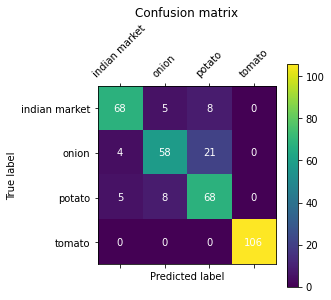

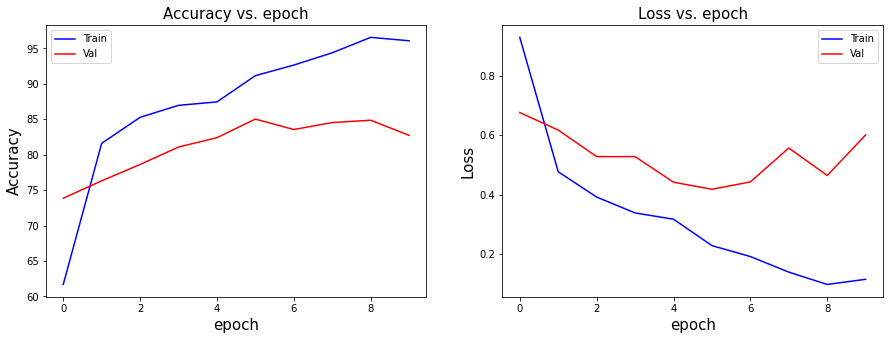

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15, 5))
ax = axes.ravel()

#accuracy graph
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['accuracy']], label='Train', color='b')
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['val_accuracy']], label='Val', color='r')
ax[0].set_title('Accuracy vs. epoch', fontsize=15)
ax[0].set_ylabel('Accuracy', fontsize=15)
ax[0].set_xlabel('epoch', fontsize=15)
ax[0].legend()

#loss graph
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['loss'], label='Train', color='b')
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['val_loss'], label='Val', color='r')
ax[1].set_title('Loss vs. epoch', fontsize=15)
ax[1].set_ylabel('Loss', fontsize=15)
ax[1].set_xlabel('epoch', fontsize=15)
ax[1].legend()

#display the graph
plt.show()

In [ ]:
import os
import numpy as np
import tensorflow as tf
tf.keras.utils.set_random_seed(111)
from tensorflow import keras
from tensorflow.keras import layers, regularizers
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn.metrics as metrics
%matplotlib inline

In [ ]:
# helper function to annotate maximum values in the plots
def annot_max(x,y, xytext=(0.94,0.96), ax=None, only_y=True):
    xmax = x[np.argmax(y)]
    ymax = max(y)
    if only_y:
        text = "{:.2f}%".format(ymax)
    else:
        text= "x={:.2f}, y={:.2f}%".format(xmax, ymax)
    if not ax:
        ax=plt.gca()
    bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
    arrowprops=dict(arrowstyle="->",connectionstyle="angle,angleA=0,angleB=60")
    kw = dict(xycoords='data',textcoords="axes fraction",
              arrowprops=arrowprops, bbox=bbox_props, ha="right", va="top")
    ax.annotate(text, xy=(xmax, ymax), xytext=xytext, **kw)

def plot_accuracy(model_fit):
    #accuracy graph
    x = range(0,len(model_fit.history['accuracy']))
    y_train = [acc * 100 for acc in model_fit.history['accuracy']]
    y_val = [acc * 100 for acc in model_fit.history['val_accuracy']]

    plt.plot(x, y_train, label='Train', color='b')
    annot_max(x, y_train, xytext=(0.7,0.9))
    plt.plot(x, y_val, label='Val', color='r')
    annot_max(x, y_val, xytext=(0.8,0.7))
    plt.ylabel('Accuracy', fontsize=15)
    plt.xlabel('epoch', fontsize=15)
    plt.legend()
    plt.show()
    

## **CNN architecture 2:**

In [ ]:
def architecture_2(height=128, width=128,num_classes=4):
    hidden_size = 256

    model = keras.Sequential(
        name="model_cnn_3",
        layers=[
            layers.Conv2D(filters=16, 
                          kernel_size=3, 
                          padding="same", 
                          input_shape=(height, width, 3),
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=32, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=64, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=128, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=256, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            # layers.MaxPooling2D(),
            # layers.Flatten(),
            layers.GlobalAveragePooling2D(),
            layers.Dense(units=hidden_size, kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.Dropout(0.5),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
model = architecture_2()
model.summary()

Model: "model_cnn_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 128, 128, 16)      448       
                                                                 
 activation (Activation)     (None, 128, 128, 16)      0         
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 16)     64        
 ormalization)                                                   
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 64, 64, 16)       0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 64, 64, 32)        4640      
                                                                 
 activation_1 (Activation)   (None, 64, 64, 32)        

In [ ]:
def compile_train_v2(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    callbacks = [
        keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.3, patience=5, min_lr=0.00001
        ),
        keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
        keras.callbacks.EarlyStopping(
            monitor="val_loss", patience=10, min_delta=0.001, mode='min'
        )
    ]
    model.compile(optimizer='adam',
                loss='categorical_crossentropy',
                metrics=['accuracy'])
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, callbacks=callbacks)
    return model_fit

In [ ]:
model_fit = compile_train_v2(model, train_data, val_data, epochs=100)

Epoch 1/100
79/79 [==============================] - 57s 252ms/step - loss: 1.4031 - accuracy: 0.7316 - val_loss: 2.0937 - val_accuracy: 0.2885 - lr: 0.0010
Epoch 2/100
79/79 [==============================] - 16s 198ms/step - loss: 1.1507 - accuracy: 0.7905 - val_loss: 3.3518 - val_accuracy: 0.2869 - lr: 0.0010
Epoch 3/100
79/79 [==============================] - 15s 193ms/step - loss: 1.0578 - accuracy: 0.8108 - val_loss: 3.3650 - val_accuracy: 0.2869 - lr: 0.0010
Epoch 4/100
79/79 [==============================] - 17s 217ms/step - loss: 0.9789 - accuracy: 0.8395 - val_loss: 3.1273 - val_accuracy: 0.3974 - lr: 0.0010
Epoch 5/100
79/79 [==============================] - 15s 197ms/step - loss: 0.9097 - accuracy: 0.8423 - val_loss: 1.6772 - val_accuracy: 0.6362 - lr: 0.0010
Epoch 6/100
79/79 [==============================] - 15s 188ms/step - loss: 0.8235 - accuracy: 0.8686 - val_loss: 1.1002 - val_accuracy: 0.7324 - lr: 0.0010
Epoch 7/100
79/79 [==============================] - 15s 1

In [ ]:
# model_fit = model.fit(
#     train_data,
#     steps_per_epoch=train_data.samples//train_data.batch_size, # set the steps per epoch
#     validation_data=val_data,
#     validation_steps=val_data.samples//val_data.batch_size, # set the validation steps
#     epochs=10 # set the number of epochs
# )


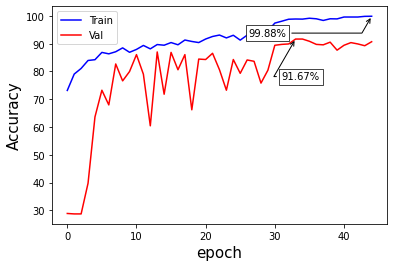

In [ ]:
plot_accuracy(model_fit)

11/11 [==============================] - 4s 315ms/step - loss: 0.6415 - accuracy: 0.8490
Test accuracy: 0.8490028381347656


11/11 [==============================] - 2s 149ms/step
Confusion matrix:
[[ 58  17   5   1]
 [  2  70  11   0]
 [  3  14  64   0]
 [  0   0   0 106]]
Classification report:
               precision    recall  f1-score   support

indian market       0.92      0.72      0.81        81
        onion       0.69      0.84      0.76        83
       potato       0.80      0.79      0.80        81
       tomato       0.99      1.00      1.00       106

     accuracy                           0.85       351
    macro avg       0.85      0.84      0.84       351
 weighted avg       0.86      0.85      0.85       351







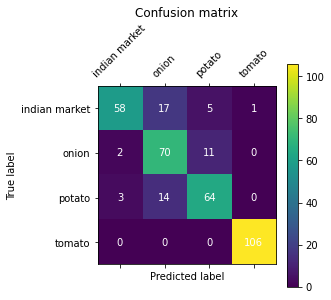

In [ ]:
test_loss, test_acc = model.evaluate(test_data)


print('Test accuracy:', test_acc)

print()
print()


y_true = test_data.labels
y_pred = np.argmax(model.predict(test_data), axis=-1)

from sklearn.metrics import classification_report, confusion_matrix

cm = confusion_matrix(y_true, y_pred)



print('Confusion matrix:')
print(cm)

# Print the classification report
class_names = list(train_data.class_indices.keys())
report = classification_report(y_true, y_pred, target_names=class_names)
print('Classification report:')
print(report)

print()
print()
print()
print()


# Plot confusion matrix
plt.matshow(cm)
plt.title('Confusion matrix')
plt.colorbar()
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.xticks(np.arange(len(class_names)), class_names, rotation=45)
plt.yticks(np.arange(len(class_names)), class_names)


# Add text annotations to confusion matrix
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, cm[i, j], ha='center', va='center', color='white')

plt.show()

### Functions : 

In [19]:
def plot_acc_loss(model_history, n_epochs):

  fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
  ax = axes.ravel()

  #accuracy graph
  ax[0].plot(range(0, n_epochs), [acc * 100 for acc in model_history.history['accuracy']], label='Train', color='b')
  ax[0].plot(range(0, n_epochs), [acc * 100 for acc in model_history.history['val_accuracy']], label='Val', color='r')
  ax[0].set_title('Accuracy vs. epoch', fontsize=15)
  ax[0].set_ylabel('Accuracy', fontsize=15)
  ax[0].set_xlabel('epoch', fontsize=15)
  ax[0].legend()

  #loss graph
  ax[1].plot(range(0, n_epochs), model_history.history['loss'], label='Train', color='b')
  ax[1].plot(range(0, n_epochs), model_history.history['val_loss'], label='Val', color='r')
  ax[1].set_title('Loss vs. epoch', fontsize=15)
  ax[1].set_ylabel('Loss', fontsize=15)
  ax[1].set_xlabel('epoch', fontsize=15)
  ax[1].legend()

  #display the graph
  plt.show()


def conf_mat(class_path, pred_list, model_name) :
    noise, tomato, potato, onion = 0, 0, 0, 0
    for i in os.listdir(class_path):

        img = tf.keras.utils.load_img(class_path + "/" + str(i))
        img = tf.keras.utils.img_to_array(img)
        img = tf.image.resize(img, (256, 256))
        img = tf.expand_dims(img, axis = 0)

        pred = model_name.predict(img)
        predicted = tf.argmax(pred, 1).numpy().item()

        if predicted == 0:
            noise+= 1
        elif predicted == 1:
            onion+= 1
        elif predicted == 2:
            potato+= 1
        else:
            tomato+= 1  


    for item in noise, onion, potato, tomato :
        pred_list.append(item)

In [ ]:
## 

## Pre-processing : 

In [4]:
train_dir = '/content/ninjacart_data/train'
test_dir = '/content/ninjacart_data/test'

In [5]:
# Specifying the image size to resize all images
image_size = (256, 256)

In [6]:
train_ds = tf.keras.utils.image_dataset_from_directory(directory = train_dir,
                                                       label_mode = 'categorical',
                                                       batch_size = 32,
                                                       image_size = image_size,
                                                       seed = 2022,
                                                       validation_split = 0.2,
                                                       subset = "training",
                                                       shuffle=True)

Found 3135 files belonging to 4 classes.
Using 2508 files for training.


In [7]:
test_ds = tf.keras.utils.image_dataset_from_directory(directory = test_dir,
                                                       label_mode = 'categorical',
                                                       batch_size = 32,
                                                       image_size = image_size,
                                                       seed = 2022,
                                                      )

Found 351 files belonging to 4 classes.


In [8]:
valid_ds = tf.keras.utils.image_dataset_from_directory(directory = train_dir,
                                                       label_mode = 'categorical',
                                                       batch_size = 32,
                                                       image_size = image_size,
                                                       seed = 2022,
                                                       validation_split = 0.2,
                                                       subset = "validation")

Found 3135 files belonging to 4 classes.
Using 627 files for validation.


In [10]:
class_names = ['indian market', 'onion', 'potato', 'tomato']

In [16]:
augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal_and_vertical"),
    tf.keras.layers.RandomRotation(0.2),
    tf.keras.layers.RandomTranslation(height_factor = 0.2, width_factor=0.2)
])

aug_ds = train_ds 

for image, label in aug_ds :
  image = augmentation(image)

## **VGG-19**

In [12]:
base_model_3 = tf.keras.applications.vgg19.VGG19(input_shape=(256, 256, 3), include_top = False)

80134624/80134624 [==============================] - 4s 0us/step


In [13]:
# append classification layer
model_3 = base_model_3.output

model_3 = tf.keras.Sequential([
            tf.keras.layers.Rescaling(1./255),
            tf.keras.layers.InputLayer(input_shape=[image_size[0], image_size[1], 3]),
            base_model_3,
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dropout(rate = 0.1),
            tf.keras.layers.Dense(4, activation = 'softmax')
        ])

In [20]:
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 256, 256, 3)       0         
                                                                 
 input_2 (InputLayer)        multiple                  0         
                                                                 
 vgg19 (Functional)          (None, 8, 8, 512)         20024384  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                          
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense (Dense)               (None, 4)                 2052      
                                                        

In [14]:
model_3.compile(
              optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              metrics = ['accuracy', 'Precision', 'Recall']
              )

In [15]:
log_dir_5 = "logs/VGG19"

tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir_5, histogram_freq=1)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("VGG19", save_best_only=True)

early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss', patience = 5, restore_best_weights=True
)

In [18]:
history_3 = model_3.fit(aug_ds, 
                        validation_data = valid_ds,
                        epochs = 25, 
                        callbacks=[tensorboard_cb, 
                                   checkpoint_cb, 
                                   early_stopping_cb])

Epoch 1/25
79/79 [==============================] - ETA: 0s - loss: 0.6744 - accuracy: 0.7113 - precision: 0.7988 - recall: 0.6124

79/79 [==============================] - 78s 980ms/step - loss: 0.6744 - accuracy: 0.7113 - precision: 0.7988 - recall: 0.6124 - val_loss: 0.3900 - val_accuracy: 0.8469 - val_precision: 0.8846 - val_recall: 0.8070
Epoch 2/25
79/79 [==============================] - ETA: 0s - loss: 0.3148 - accuracy: 0.8800 - precision: 0.8937 - recall: 0.8652

79/79 [==============================] - 67s 835ms/step - loss: 0.3148 - accuracy: 0.8800 - precision: 0.8937 - recall: 0.8652 - val_loss: 0.2839 - val_accuracy: 0.8963 - val_precision: 0.9130 - val_recall: 0.8868
Epoch 3/25
79/79 [==============================] - ETA: 0s - loss: 0.2199 - accuracy: 0.9250 - precision: 0.9305 - recall: 0.9187

79/79 [==============================] - 65s 817ms/step - loss: 0.2199 - accuracy: 0.9250 - precision: 0.9305 - recall: 0.9187 - val_loss: 0.2344 - val_accuracy: 0.9330 - val_precision: 0.9389 - val_recall: 0.9314
Epoch 4/25
79/79 [==============================] - 61s 770ms/step - loss: 0.1912 - accuracy: 0.9250 - precision: 0.9329 - recall: 0.9207 - val_loss: 0.2357 - val_accuracy: 0.9266 - val_precision: 0.9326 - val_recall: 0.9266
Epoch 5/25
79/79 [==============================] - 60s 753ms/step - loss: 0.1846 - accuracy: 0.9378 - precision: 0.9451 - recall: 0.9334 - val_loss: 0.2452 - val_accuracy: 0.9378 - val_precision: 0.9438 - val_recall: 0.9378
Epoch 6/25
79/79 [==============================] - ETA: 0s - loss: 0.1476 - accuracy: 0.9533 - precision: 0.9574 - recall: 0.9502

79/79 [==============================] - 65s 811ms/step - loss: 0.1476 - accuracy: 0.9533 - precision: 0.9574 - recall: 0.9502 - val_loss: 0.2186 - val_accuracy: 0.9474 - val_precision: 0.9503 - val_recall: 0.9458
Epoch 7/25
79/79 [==============================] - 62s 774ms/step - loss: 0.1294 - accuracy: 0.9533 - precision: 0.9556 - recall: 0.9518 - val_loss: 0.2742 - val_accuracy: 0.9107 - val_precision: 0.9165 - val_recall: 0.9107
Epoch 8/25
79/79 [==============================] - ETA: 0s - loss: 0.0761 - accuracy: 0.9713 - precision: 0.9751 - recall: 0.9697

79/79 [==============================] - 65s 813ms/step - loss: 0.0761 - accuracy: 0.9713 - precision: 0.9751 - recall: 0.9697 - val_loss: 0.1762 - val_accuracy: 0.9649 - val_precision: 0.9696 - val_recall: 0.9649
Epoch 9/25
79/79 [==============================] - 61s 767ms/step - loss: 0.1255 - accuracy: 0.9577 - precision: 0.9611 - recall: 0.9545 - val_loss: 0.1778 - val_accuracy: 0.9553 - val_precision: 0.9599 - val_recall: 0.9553
Epoch 10/25
79/79 [==============================] - 60s 753ms/step - loss: 0.1216 - accuracy: 0.9581 - precision: 0.9614 - recall: 0.9545 - val_loss: 0.2304 - val_accuracy: 0.9250 - val_precision: 0.9337 - val_recall: 0.9203
Epoch 11/25
79/79 [==============================] - 61s 759ms/step - loss: 0.0894 - accuracy: 0.9665 - precision: 0.9687 - recall: 0.9629 - val_loss: 0.3555 - val_accuracy: 0.9091 - val_precision: 0.9109 - val_recall: 0.8963
Epoch 12/25
79/79 [==============================] - 60s 757ms/step - loss: 0.0811 - accuracy: 0.9713 - preci

In [86]:
def classwise_accuracy(class_path, class_name, model_name) :
    paths = []
    for i in os.listdir(class_path):
        paths.append(class_path + "/" + str(i))

    correct = 0
    total = 0

    for i in range(len(paths)):
        total+= 1

        img = tf.keras.utils.load_img(paths[i])
        img = tf.keras.utils.img_to_array(img)
        img = tf.image.resize(img, (256, 256))
        img = tf.expand_dims(img, axis = 0)

        pred = model_name.predict(img,verbose=0)
        if tf.argmax(pred[0]) == class_names.index(f"{class_name}"):
            correct+= 1   

    print(f"Accuracy for class {class_name} is {round((correct/total)*100, 2)}% consisting of {len(paths)} images")

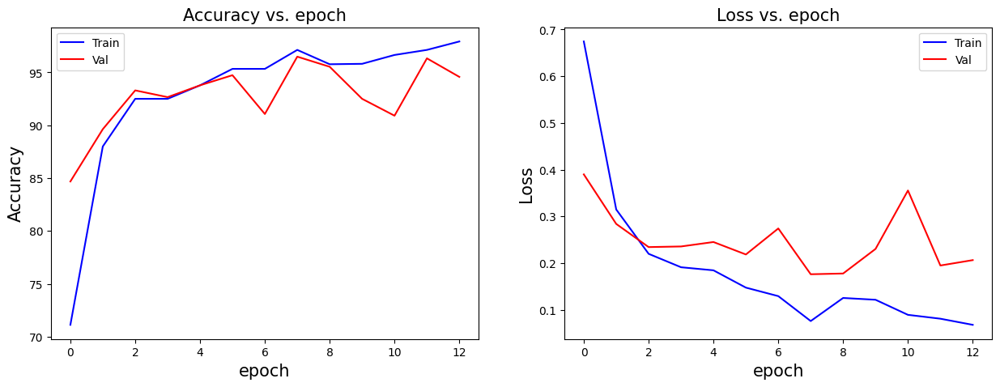

In [87]:
def plot_acc_loss(model_history, n_epochs):

  fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
  ax = axes.ravel()

  #accuracy graph
  ax[0].plot(range(0, n_epochs), [acc * 100 for acc in model_history.history['accuracy']], label='Train', color='b')
  ax[0].plot(range(0, n_epochs), [acc * 100 for acc in model_history.history['val_accuracy']], label='Val', color='r')
  ax[0].set_title('Accuracy vs. epoch', fontsize=15)
  ax[0].set_ylabel('Accuracy', fontsize=15)
  ax[0].set_xlabel('epoch', fontsize=15)
  ax[0].legend()

  #loss graph
  ax[1].plot(range(0, n_epochs), model_history.history['loss'], label='Train', color='b')
  ax[1].plot(range(0, n_epochs), model_history.history['val_loss'], label='Val', color='r')
  ax[1].set_title('Loss vs. epoch', fontsize=15)
  ax[1].set_ylabel('Loss', fontsize=15)
  ax[1].set_xlabel('epoch', fontsize=15)
  ax[1].legend()

  #display the graph
  plt.show()

plot_acc_loss(history_3, n_epochs = 13)

In [88]:
noise_path = '/content/ninjacart_data/test/indian market'
onion_path = '/content/ninjacart_data/test/onion'
potato_path = '/content/ninjacart_data/test/potato'
tomato_path = '/content/ninjacart_data/test/tomato'

classwise_accuracy(noise_path, 'indian market', model_3)
classwise_accuracy(onion_path, 'onion', model_3)
classwise_accuracy(potato_path, 'potato', model_3)
classwise_accuracy(tomato_path, 'tomato', model_3)

Accuracy for class indian market is 87.65% consisting of 81 images
Accuracy for class onion is 100.0% consisting of 83 images
Accuracy for class potato is 86.42% consisting of 81 images
Accuracy for class tomato is 100.0% consisting of 106 images


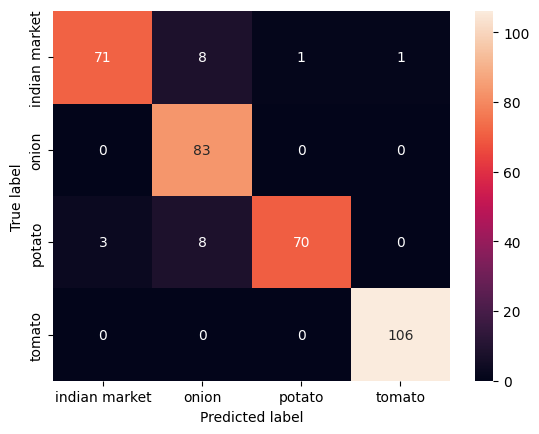

In [89]:
def conf_mat(class_path, pred_list, model_name) :
    noise, tomato, potato, onion = 0, 0, 0, 0
    for i in os.listdir(class_path):

        img = tf.keras.utils.load_img(class_path + "/" + str(i))
        img = tf.keras.utils.img_to_array(img)
        img = tf.image.resize(img, (256, 256))
        img = tf.expand_dims(img, axis = 0)

        pred = model_name.predict(img,verbose=0)
        predicted = tf.argmax(pred, 1).numpy().item()

        if predicted == 0:
            noise+= 1
        elif predicted == 1:
            onion+= 1
        elif predicted == 2:
            potato+= 1
        else:
            tomato+= 1  


    for item in noise, onion, potato, tomato :
        pred_list.append(item)

l1 = []
l2 = []
l3 = []
l4 = []

conf_mat(noise_path, l1, model_3)
conf_mat(onion_path, l2, model_3)
conf_mat(potato_path, l3, model_3)
conf_mat(tomato_path, l4, model_3)

ax = sns.heatmap([l1, l2, l3, l4], xticklabels=class_names, yticklabels=class_names, annot=True, fmt='g')
ax.set(xlabel='Predicted label', ylabel='True label')
plt.show()

In [37]:
result = model_3.evaluate(test_ds)
dict(zip(model_3.metrics_names, result))

11/11 [==============================] - 10s 736ms/step - loss: 0.2026 - accuracy: 0.9402 - precision: 0.9398 - recall: 0.9345


{'loss': 0.20257778465747833,
 'accuracy': 0.94017094373703,
 'precision': 0.939828097820282,
 'recall': 0.934472918510437}

## **ResNet**

In [38]:
base_model_1 = tf.keras.applications.resnet50.ResNet50(input_shape=(256, 256, 3), include_top = False)

94765736/94765736 [==============================] - 5s 0us/step


In [39]:
# append classification layer
model_1 = base_model_1.output

model_1 = tf.keras.Sequential([
            #Normalizing 0-255 into 0 to 1
            tf.keras.layers.Rescaling(1./255),
            tf.keras.layers.InputLayer(input_shape=[image_size[0], image_size[1], 3]),
            base_model_1,
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dropout(rate = 0.1),
            tf.keras.layers.Dense(4, activation = 'softmax')
        ])

In [40]:
model_1.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              metrics = ['accuracy', 'Precision', 'Recall'])

In [48]:
model_1.summary() 

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 256, 256, 3)       0         
                                                                 
 input_4 (InputLayer)        multiple                  0         
                                                                 
 resnet50 (Functional)       (None, 8, 8, 2048)        23587712  
                                                                 
 global_average_pooling2d_1   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dropout_1 (Dropout)         (None, 2048)              0         
                                                                 
 dense_1 (Dense)             (None, 4)                 8196      
                                                      

In [41]:
log_dir_3 = "logs/ResNet"

tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=log_dir_3, histogram_freq=1)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("ResNet.h5", save_best_only=True)

early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss', patience = 5, restore_best_weights=True
)

In [42]:
history_1 = model_1.fit(aug_ds, 
                        validation_data = valid_ds, 
                        epochs = 20, 
                        callbacks=[tensorboard_cb, 
                                   checkpoint_cb,
                                   early_stopping_cb])

Epoch 1/20
79/79 [==============================] - 98s 614ms/step - loss: 0.1930 - accuracy: 0.9290 - precision: 0.9427 - recall: 0.9183 - val_loss: 3.7173 - val_accuracy: 0.2121 - val_precision: 0.2121 - val_recall: 0.2121
Epoch 2/20
79/79 [==============================] - 42s 529ms/step - loss: 0.0200 - accuracy: 0.9948 - precision: 0.9948 - recall: 0.9940 - val_loss: 2.1190 - val_accuracy: 0.2073 - val_precision: 0.2017 - val_recall: 0.1946
Epoch 3/20
79/79 [==============================] - 44s 554ms/step - loss: 0.0195 - accuracy: 0.9960 - precision: 0.9960 - recall: 0.9956 - val_loss: 3.3367 - val_accuracy: 0.2026 - val_precision: 0.2019 - val_recall: 0.2010
Epoch 4/20
79/79 [==============================] - 43s 538ms/step - loss: 0.0069 - accuracy: 0.9980 - precision: 0.9980 - recall: 0.9980 - val_loss: 4.0221 - val_accuracy: 0.1914 - val_precision: 0.1920 - val_recall: 0.1914
Epoch 5/20
79/79 [==============================] - 41s 509ms/step - loss: 0.0308 - accuracy: 0.9932

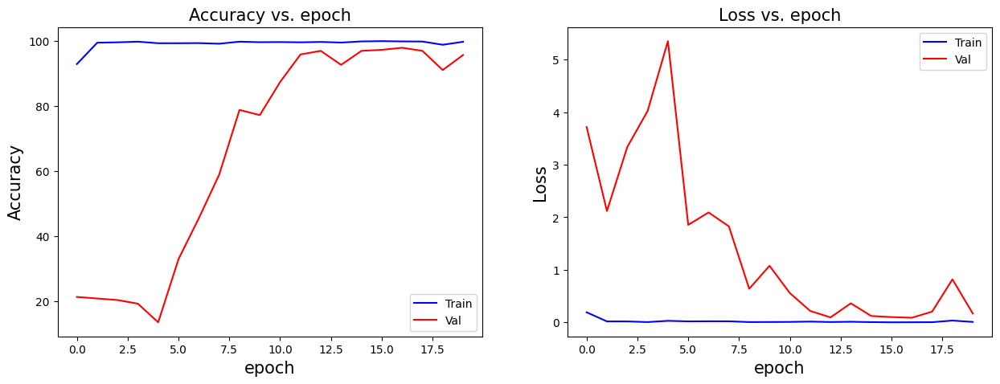

In [43]:

plot_acc_loss(history_1, n_epochs = 20)

In [90]:
noise_path = '/content/ninjacart_data/test/indian market'
onion_path = '/content/ninjacart_data/test/onion'
potato_path = '/content/ninjacart_data/test/potato'
tomato_path = '/content/ninjacart_data/test/tomato'

classwise_accuracy(noise_path, 'indian market', model_1)
classwise_accuracy(onion_path, 'onion', model_1)
classwise_accuracy(potato_path, 'potato', model_1)
classwise_accuracy(tomato_path, 'tomato', model_1)

Accuracy for class indian market is 98.77% consisting of 81 images
Accuracy for class onion is 98.8% consisting of 83 images
Accuracy for class potato is 85.19% consisting of 81 images
Accuracy for class tomato is 100.0% consisting of 106 images


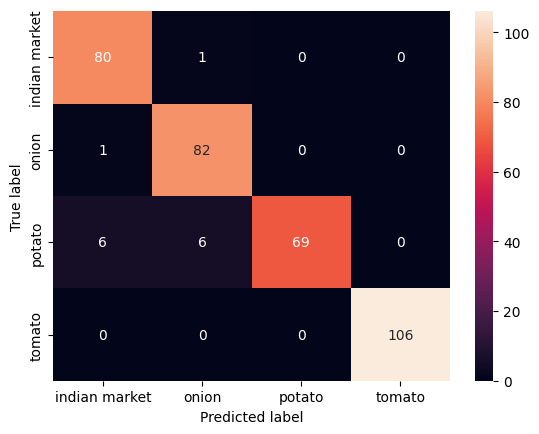

In [91]:
l1 = []
l2 = []
l3 = []
l4 = []

conf_mat(noise_path, l1, model_1)
conf_mat(onion_path, l2, model_1)
conf_mat(potato_path, l3, model_1)
conf_mat(tomato_path, l4, model_1)

ax = sns.heatmap([l1, l2, l3, l4], xticklabels=class_names, yticklabels=class_names, annot=True, fmt='g')
ax.set(xlabel='Predicted label', ylabel='True label')
plt.show()

In [47]:
result = model_1.evaluate(test_ds)
dict(zip(model_1.metrics_names, result))

11/11 [==============================] - 4s 262ms/step - loss: 0.1591 - accuracy: 0.9630 - precision: 0.9628 - recall: 0.9573


{'loss': 0.15911954641342163,
 'accuracy': 0.9629629850387573,
 'precision': 0.9627507328987122,
 'recall': 0.9572649598121643}

In [57]:
test_ds.class_names

['indian market', 'onion', 'potato', 'tomato']

In [58]:
test_loss, test_acc, test_precision, test_recall = model_1.evaluate(test_ds)


11/11 [==============================] - 3s 126ms/step - loss: 0.1591 - accuracy: 0.9630 - precision: 0.9628 - recall: 0.9573


In [59]:
print('Test accuracy:', test_acc)

print()
print()

Test accuracy: 0.9629629850387573




## Model Comparison:

---
### ANN
    Total params: 12,649,988
    Trainable params: 12,649,988
    Non-trainable params: 0

    loss: 1.0572 
    Test accuracy: 0.6153846383094788
    precision: 0.62  
    recall: 0.62 


-----
### CNN

#### Architecture 1: 
    Total params: 4,288,196
    Trainable params: 4,288,196
    Non-trainable params: 0
    loss: 0.5620 
    Test-accuracy: 0.8547
    precision: 0.86  
    recall: 0.85 



#### CNN architecture 2:

    Total params: 462,436
    Trainable params: 460,932
    Non-trainable params: 1,504

    loss: 0.6415 
    Test accuracy: 0.8490028381347656
    precision: 0.86 
    recall: 0.85




-------------

### VGG-19

    Total params: 20,026,436
    Trainable params: 20,026,436
    Non-trainable params: 0.

    loss: 0.2026 
    Test-accuracy: 0.9402
    precision: 0.9398 
    recall: 0.9345

-----------------------------------------------------------------
### ResNet50

    Total params: 23,595,908
    Trainable params: 23,542,788
    Non-trainable params: 53,120

    loss : 0.1591
    Test-accuracy: 0.9630
    precision: 0.9628
    recall: 0.9573


| Model | Test Accuracy|
| --- | --- | 
| ANN  | 62% |
| CNN-1 |  85%|
| CNN-2 | 84% |
| VGG-19 | 94% |
| ResNet50 | 96% |

<br>

    ### With Model  ResNet50 : 

    Accuracy for class indian market is 98.77% consisting of 81 images
    Accuracy for class onion is 98.8% consisting of 83 images
    Accuracy for class potato is 85.19% consisting of 81 images
    Accuracy for class tomato is 100.0% consisting of 106 images

In [84]:
%load_ext tensorboard
%tensorboard --logdir /content/logs

Output hidden; open in https://colab.research.google.com to view.

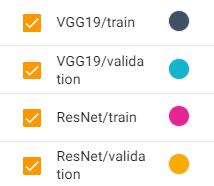

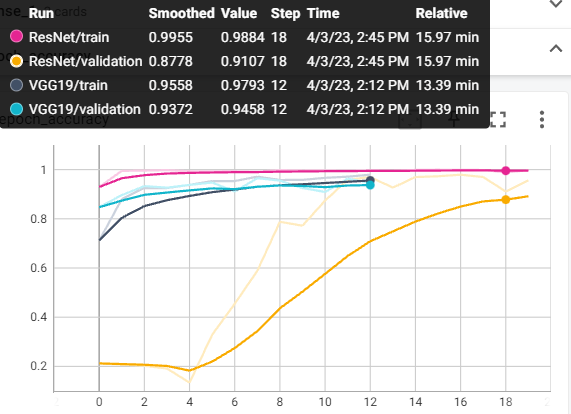

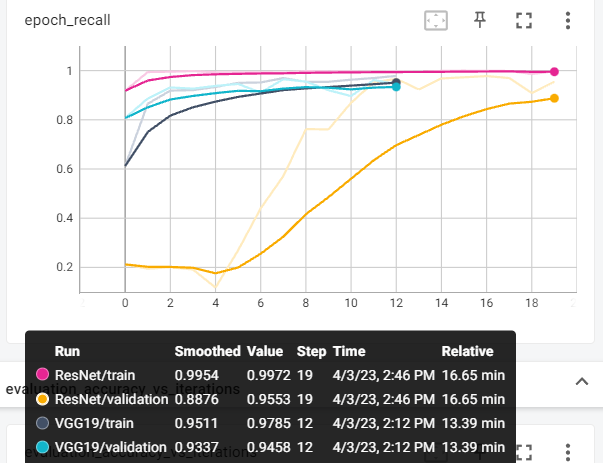